In [32]:
from Experiment import (
    Experimenting,
    DatasetConfig,
    DSC,
    DSCLoss,
    CE,
    Accuracy,
    Precision,
    Recall,
    IoU,
    NewTrainConfig,
    logger,
    MedNeXt,
    NnUnet,
    RandomFlip3D,
    Resize
)
import torch
from torchvision import datasets, transforms

In [33]:
torch.manual_seed(0)
datasetConfig = DatasetConfig(
    window_center=400,
    window_width=1000,
    device="cuda",
    compose= {
        "train": transforms.Compose([
            transforms.Lambda(lambda x: (torch.tensor(x[0]).unsqueeze(0).float(), torch.tensor(x[1]).unsqueeze(0).float())),
            Resize((128)),
            RandomFlip3D(axes=(0, 1, 2), flip_prob=0.5),
        ]),
        "val": transforms.Compose([
            transforms.Lambda(lambda x: (torch.tensor(x[0]).unsqueeze(0).float(), torch.tensor(x[1]).unsqueeze(0).float())),
            Resize((128)),
        ]),
        "test": transforms.Compose([
            # transforms.Lambda(lambda x: (torch.tensor(x[0]).unsqueeze(0).float(), torch.tensor(x[1]).unsqueeze(0).float())),
            Resize((128)),
        ]),
    }
)

In [34]:
# check gpu
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device


device(type='cuda')

In [35]:
experimentOne = Experimenting[torch.tensor, torch.tensor](
    "perfect_one",
    "split.json",
    datasetConfig,
    [DSCLoss(3), CE()],
    [DSC(), CE(), Accuracy(), Precision(3), Recall(3)],
    3,
    logger,
)
experimentOne.add_trainer(
    NnUnet,
    "mednext_three",
    num_input_channels=1,
    channels_multiplier=2,
)

[INFO][main.DataEngine][transform to npz]: Data already transformed to npz 
[INFO][main][initialize data engine]: DataEngine initialized with meta data from data 
[INFO][main.Experimenting.perfect_one][initialize experiment]: Experimenting initialized. 
[INFO][main.Experimenting.perfect_one][add trainer]: Added NnUnet to the experiment. 


In [36]:
test_dataload = experimentOne.data_engine.get_dataloader("test", batch_size=2)

[INFO][main.DataEngine][get data]: Getting data from test set 
[INFO][main.DataEngine][create dataloader]: Creating dataloader for test set 


# Inference Part


In [37]:
for (idx, input, mask) in test_dataload:
    print(idx, input.shape, mask.shape)
    break

c:\Users\punn_\Documents\Punnawat\Medical-Data-Loader\venv\lib\site-packages\torchio\data\image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/fepegar/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)
c:\Users\punn_\Documents\Punnawat\Medical-Data-Loader\venv\lib\site-packages\torchio\data\image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://githu

tensor([0, 1]) torch.Size([2, 1, 128, 128, 128]) torch.Size([2, 1, 128, 128, 128])


In [12]:
import matplotlib.pyplot as plt
# subplot

In [13]:
from Experiment import get_array_by_subplot, write_video, VisualBlock, SubplotBlock, windowing
import os
import SimpleITK as sitk
import numpy as np
import matplotlib.pyplot as plt
import torchio as tio

In [17]:
output = experimentOne.train_method[0].infer(data.to(experimentOne.device))

In [19]:
# output is B, C, H, W, D. softmax is applied to C

output = torch.argmax(output, dim=1)
output.shape

torch.Size([2, 128, 128, 128])

In [23]:
from matplotlib.colors import ListedColormap
cmap = ListedColormap(['black', 'green', 'blue'])

c:\Users\punn_\Documents\Punnawat\Medical-Data-Loader\Experiment\DataEngine\visualize\__init__.py:70: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(subplot_block["layout"][0], subplot_block["layout"][1])


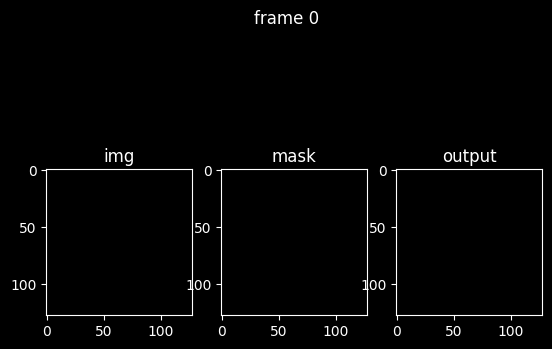

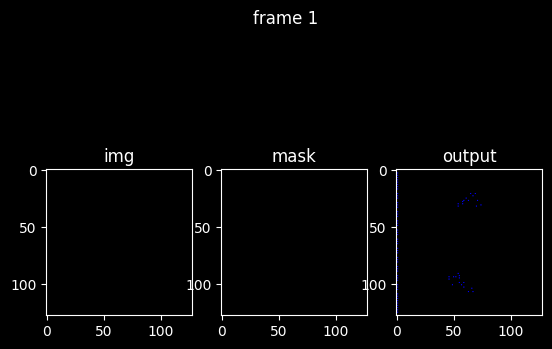

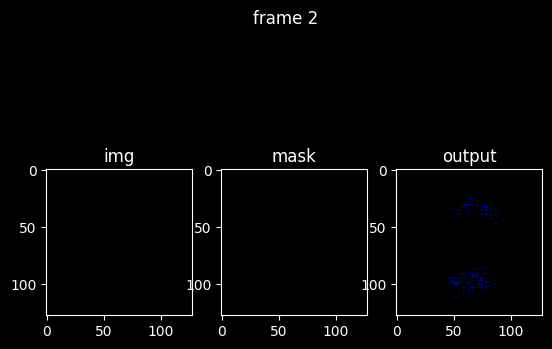

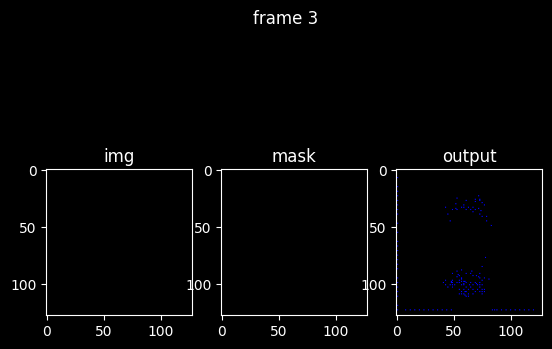

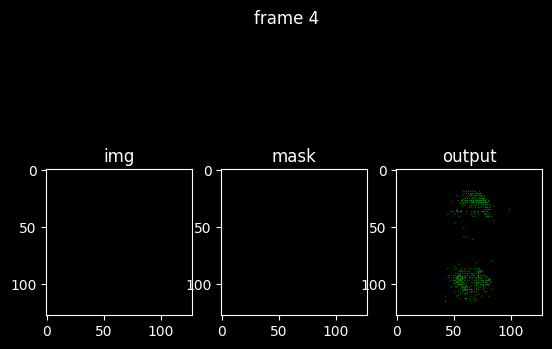

...

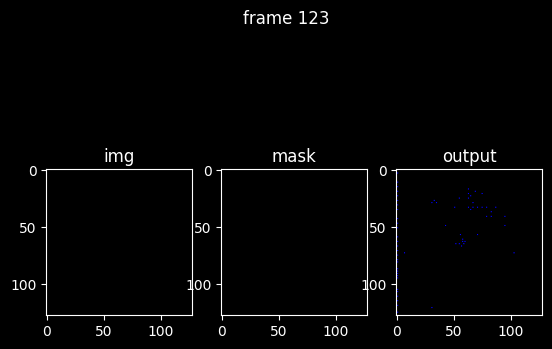

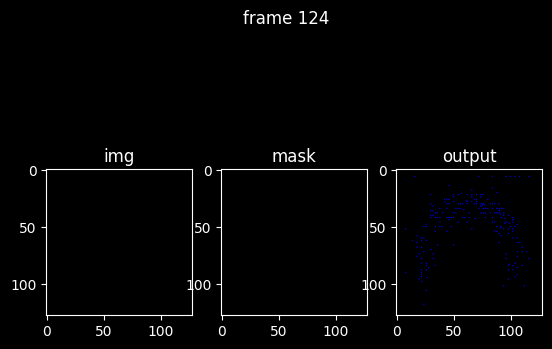

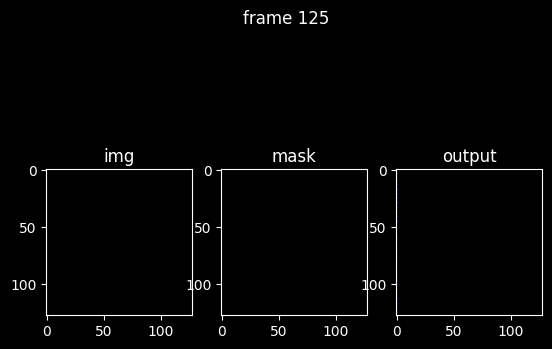

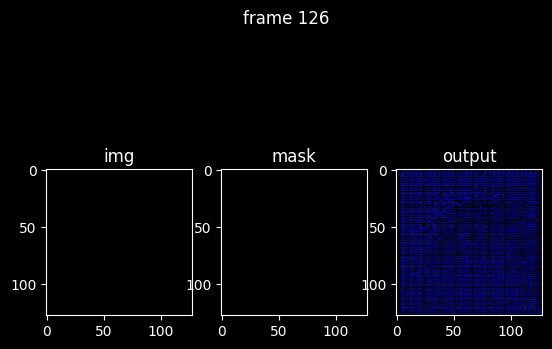

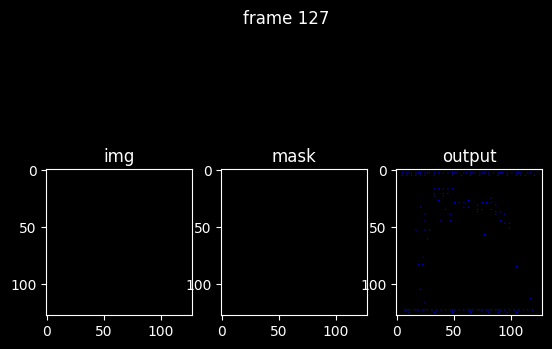

In [24]:
# skip to for loop
to_viz = []

for idx, (frame_ori, frame_mask, frame_output) in enumerate(zip(data[0][0], mask[0][0], output[0])):
    subplotBlock_ori_win = SubplotBlock(
        title=f"frame {idx}",
        layout=(1, 3),
        visual_blocks=[
            VisualBlock(
                title="img",
                img=frame_ori.cpu().numpy(),
                color_map= "gray"
            ),
            VisualBlock(
                title="mask",
                img=frame_mask.cpu().numpy(),
                color_map= cmap
            ),
            VisualBlock(
                title="output",
                img=frame_output.cpu().numpy(),
                color_map= cmap
            ),
        ]
    )
    
    to_viz.append(get_array_by_subplot(subplotBlock_ori_win))
    

    
      

In [25]:
from PIL import Image

In [26]:
import os

os.makedirs("output_nn4x", exist_ok=True)

In [27]:
test_dataload = experimentOne.data_engine.get_dataloader("test", batch_size=1)

[INFO][main.DataEngine][get data]: Getting data from test set 
[INFO][main.DataEngine][create dataloader]: Creating dataloader for test set 


c:\Users\punn_\Documents\Punnawat\Medical-Data-Loader\venv\lib\site-packages\torchio\data\image.py:248: UserWarning: Using TorchIO images without a torchio.SubjectsLoader in PyTorch >= 2.3 might have unexpected consequences, e.g., the collated batches will be instances of torchio.Subject with 5D images. Replace your PyTorch DataLoader with a torchio.SubjectsLoader so that the collated batch becomes a dictionary, as expected. See https://github.com/fepegar/torchio/issues/1179 for more context about this issue.
  warnings.warn(message, stacklevel=1)


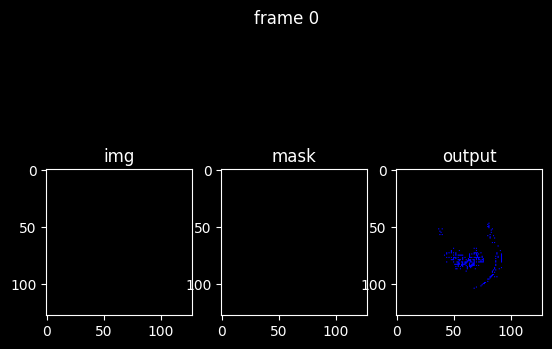

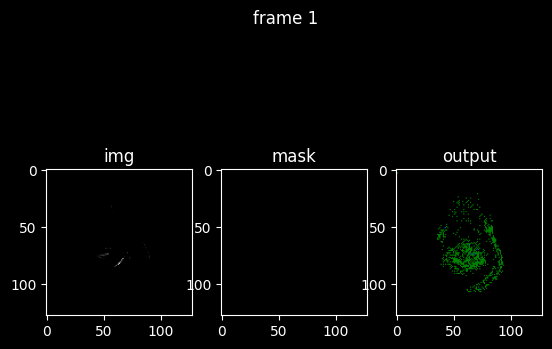

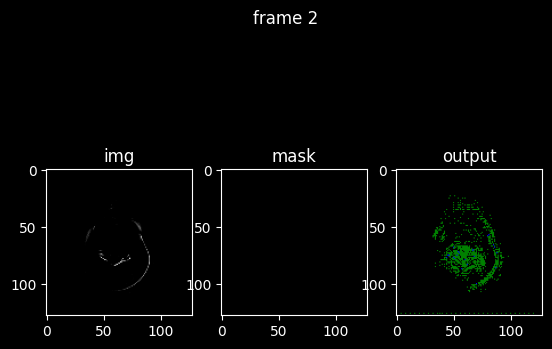

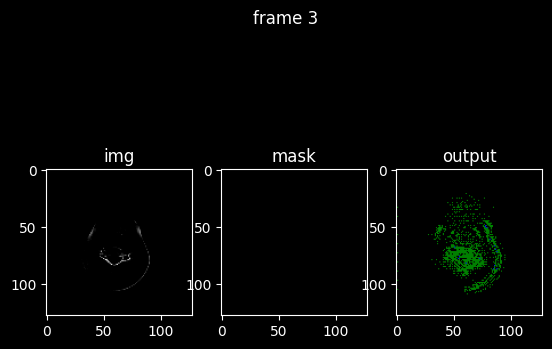

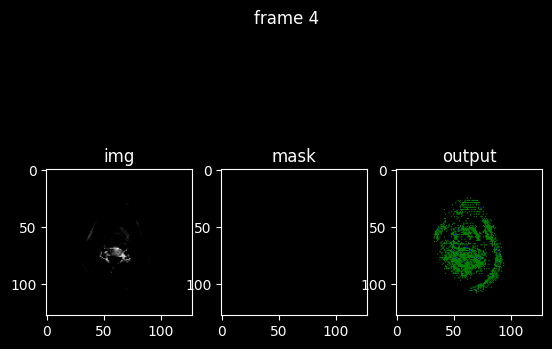

...

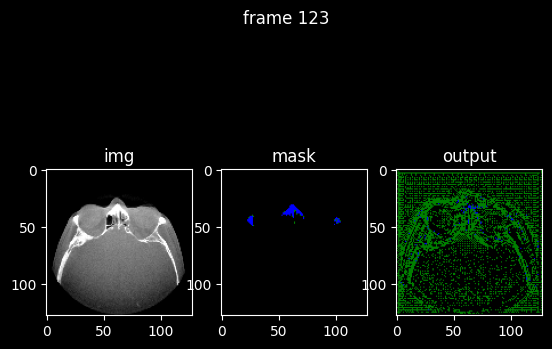

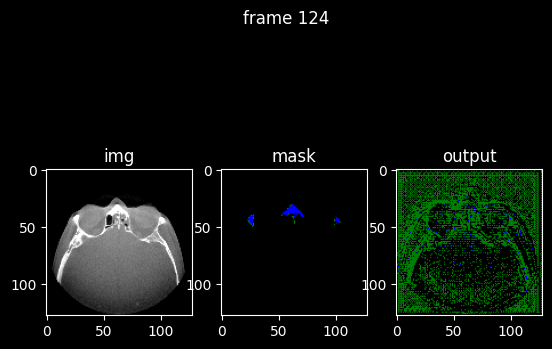

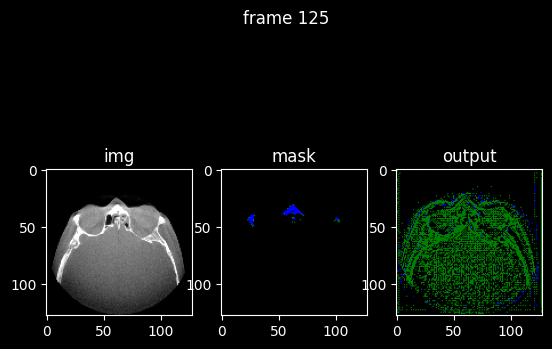

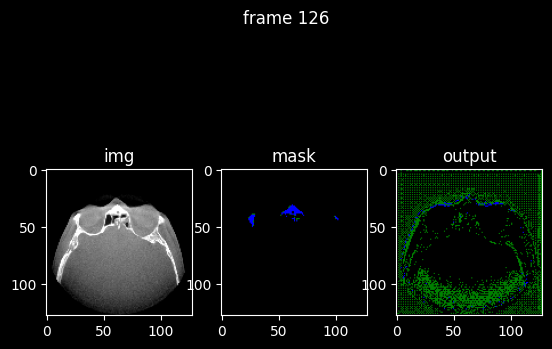

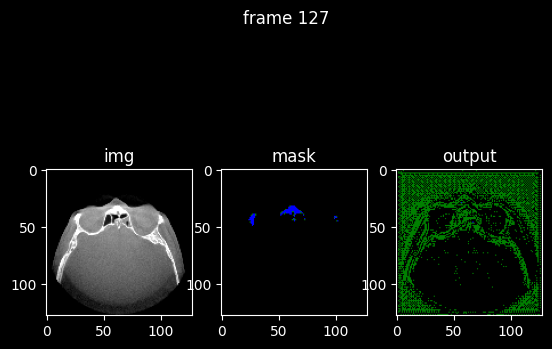

In [28]:
for i, (idx, data, mask) in enumerate(test_dataload):
    dir_path = os.path.join("output", str(i))
    os.makedirs(dir_path, exist_ok=True)
    output = experimentOne.train_method[0].infer(data.to(experimentOne.device))
    output = torch.argmax(output, dim=1)
    to_viz = []

    for frame_idx, (frame_ori, frame_mask, frame_output) in enumerate(zip(data[0][0], mask[0][0], output[0])):
        subplotBlock_ori_win = SubplotBlock(
            title=f"frame {frame_idx}",
            layout=(1, 3),
            visual_blocks=[
                VisualBlock(
                    title="img",
                    img=frame_ori.cpu().numpy(),
                    color_map= "gray"
                ),
                VisualBlock(
                    title="mask",
                    img=frame_mask.cpu().numpy(),
                    color_map= cmap
                ),
                VisualBlock(
                    title="output",
                    img=frame_output.cpu().numpy(),
                    color_map= cmap
                ),
            ]
        )
        
        # to_viz.append(get_array_by_subplot(subplotBlock_ori_win))
        Image.fromarray(get_array_by_subplot(subplotBlock_ori_win)).save(os.path.join(dir_path, "{:03}.jpg".format(frame_idx)))
    
    

In [ ]:
result_image = sitk.GetImageFromArray(data[1][0][0].cpu().numpy().astype(np.uint8))
sitk.WriteImage(result_image, "visual_{'MedNexT'}_gt.nii.gz")


In [ ]:
result_image = sitk.GetImageFromArray(output[0].cpu().numpy().astype(np.uint8))

In [ ]:
sitk.WriteImage(result_image, "visual_{'MedNexT'}_ori_win.nii.gz")

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

# Example image with values 0, 1, and 2
image = np.random.randint(0, 3, (128, 128))

# Create a colormap
cmap = ListedColormap(['red', 'green', 'blue'])

# Plot the image with the colormap
plt.imshow(image, cmap=cmap)
plt.colorbar()
plt.show()
